<a href="https://colab.research.google.com/github/zadel28/nyu-python-public-policy/blob/master/HW7.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [0]:
import pandas as pd
from google.colab import drive
import matplotlib.pyplot as plt 
import numpy as np
import statsmodels.api as sm

In [0]:
pd.set_option('display.max_columns', None)
pd.set_option('display.max_rows', None)

In [3]:
drive.mount('/content/drive')

Go to this URL in a browser: https://accounts.google.com/o/oauth2/auth?client_id=947318989803-6bn6qk8qdgf4n4g3pfee6491hc0brc4i.apps.googleusercontent.com&redirect_uri=urn%3aietf%3awg%3aoauth%3a2.0%3aoob&response_type=code&scope=email%20https%3a%2f%2fwww.googleapis.com%2fauth%2fdocs.test%20https%3a%2f%2fwww.googleapis.com%2fauth%2fdrive%20https%3a%2f%2fwww.googleapis.com%2fauth%2fdrive.photos.readonly%20https%3a%2f%2fwww.googleapis.com%2fauth%2fpeopleapi.readonly

Enter your authorization code:
··········
Mounted at /content/drive


In [4]:
df = pd.read_csv('/content/drive/My Drive/Data for Python/cleaned_311_data_revised.csv', header='infer')

/usr/local/lib/python3.6/dist-packages/IPython/core/interactiveshell.py:2718: DtypeWarning: Columns (10,19,20,22,33,36,37,38,39) have mixed types. Specify dtype option on import or set low_memory=False.
  interactivity=interactivity, compiler=compiler, result=result)


In [0]:
indicator = pd.read_csv('https://planninglabs.carto.com/api/v2/sql?format=csv&q=SELECT%20cartodb_id,the_geom,the_geom_webmercator,acres,acs_tooltip,acs_tooltip_2,acs_tooltip_3,area_sqmi,borocd,cb_email,cb_website,cd_full_title,cd_short_title,cd_son_fy2018,cd_tot_bldgs,cd_tot_resunits,count_hosp_clinic,count_libraries,count_parks,count_public_schools,crime_count,crime_count_boro,crime_count_nyc,crime_per_1000,crime_per_1000_boro,crime_per_1000_nyc,female_10_14,female_15_19,female_20_24,female_25_29,female_30_34,female_35_39,female_40_44,female_45_49,female_5_9,female_50_54,female_55_59,female_60_64,female_65_69,female_70_74,female_75_79,female_80_84,female_85_over,female_under_5,fp_100_area,fp_100_bldg,fp_100_cost_burden,fp_100_cost_burden_value,fp_100_mhhi,fp_100_mortg_value,fp_100_openspace,fp_100_ownerocc,fp_100_ownerocc_value,fp_100_permortg,fp_100_pop,fp_100_rent_burden,fp_100_rent_burden_value,fp_100_resunits,fp_500_area,fp_500_bldg,fp_500_cost_burden,fp_500_cost_burden_value,fp_500_mhhi,fp_500_mortg_value,fp_500_openspace,fp_500_ownerocc,fp_500_ownerocc_value,fp_500_permortg,fp_500_pop,fp_500_rent_burden,fp_500_rent_burden_value,fp_500_resunits,lep_rate,lep_rate_boro,lep_rate_nyc,lot_area_commercial_office,lot_area_industrial_manufacturing,lot_area_mixed_use,lot_area_open_space,lot_area_other_no_data,lot_area_parking,lot_area_public_facility_institution,lot_area_res_1_2_family_bldg,lot_area_res_multifamily_elevator,lot_area_res_multifamily_walkup,lot_area_transportation_utility,lot_area_vacant,lots_commercial_office,lots_industrial_manufacturing,lots_mixed_use,lots_open_space,lots_other_no_data,lots_parking,lots_public_facility_institution,lots_res_1_2_family_bldg,lots_res_multifamily_elevator,lots_res_multifamily_walkup,lots_total,lots_transportation_utility,lots_vacant,male_10_14,male_15_19,male_20_24,male_25_29,male_30_34,male_35_39,male_40_44,male_45_49,male_5_9,male_50_54,male_55_59,male_60_64,male_65_69,male_70_74,male_75_79,male_80_84,male_85_over,male_under_5,mean_commute,mean_commute_boro,mean_commute_nyc,moe_bach_deg,moe_bach_deg_boro,moe_bach_deg_nyc,moe_foreign_born,moe_hh_rent_burd,moe_hh_rent_burd_boro,moe_hh_rent_burd_nyc,moe_lep_rate,moe_lep_rate_boro,moe_lep_rate_nyc,moe_mean_commute,moe_mean_commute_boro,moe_mean_commute_nyc,moe_over65_rate,moe_over65_rate_boro,moe_over65_rate_nyc,moe_poverty_rate,moe_under18_rate,moe_under18_rate_boro,moe_under18_rate_nyc,moe_unemnployment,moe_unemployment_boro,moe_unemployment_cd,neighborhoods,over65_rate,over65_rate_boro,over65_rate_nyc,pct_asian_nh,pct_bach_deg,pct_bach_deg_boro,pct_bach_deg_nyc,pct_black_nh,pct_clean_strts,pct_clean_strts_boro,pct_clean_strts_nyc,pct_foreign_born,pct_hh_rent_burd,pct_hh_rent_burd_boro,pct_hh_rent_burd_nyc,pct_hispanic,pct_other_nh,pct_served_parks,pct_white_nh,pop_2000,pop_2010,pop_acs,pop_change_00_10,poverty_rate,poverty_rate_boro,poverty_rate_nyc,puma,shared_puma,shared_puma_cd,son_issue_1,son_issue_2,son_issue_3,total_lot_area,under18_rate,under18_rate_boro,under18_rate_nyc,unemployment_boro,unemployment_cd,unemployment_nyc%20FROM%20community_district_profiles&filename=indicators.csv', header='infer')

In [6]:
indicator.head()

,the_geom,lots_parking,the_geom_webmercator,acres,acs_tooltip,acs_tooltip_2,acs_tooltip_3,area_sqmi,borocd,cb_email,cb_website,cd_full_title,cd_short_title,cd_son_fy2018,cd_tot_bldgs,cd_tot_resunits,count_hosp_clinic,count_libraries,count_parks,count_public_schools,crime_count,crime_count_boro,crime_count_nyc,crime_per_1000,crime_per_1000_boro,crime_per_1000_nyc,female_10_14,female_15_19,female_20_24,female_25_29,female_30_34,female_35_39,female_40_44,female_45_49,female_5_9,female_50_54,female_55_59,female_60_64,female_65_69,female_70_74,female_75_79,female_80_84,female_85_over,female_under_5,fp_100_area,fp_100_bldg,fp_100_cost_burden,fp_100_cost_burden_value,fp_100_mhhi,fp_100_mortg_value,fp_100_openspace,fp_100_ownerocc,fp_100_ownerocc_value,fp_100_permortg,fp_100_pop,fp_100_rent_burden,fp_100_rent_burden_value,fp_100_resunits,fp_500_area,fp_500_bldg,fp_500_cost_burden,fp_500_cost_burden_value,fp_500_mhhi,fp_500_mortg_value,fp_500_openspace,fp_500_ownerocc,fp_500_ownerocc_value,fp_500_permortg,fp_500_pop,fp_500_rent_burden,fp_500_rent_burden_value,fp_500_resunits,lep_rate,lep_rate_boro,lep_rate_nyc,lot_area_commercial_office,lot_area_industrial_manufacturing,lot_area_mixed_use,lot_area_open_space,lot_area_other_no_data,lot_area_parking,lot_area_public_facility_institution,lot_area_res_1_2_family_bldg,lot_area_res_multifamily_elevator,lot_area_res_multifamily_walkup,lot_area_transportation_utility,lot_area_vacant,lots_commercial_office,lots_industrial_manufacturing,lots_mixed_use,lots_open_space,lots_other_no_data,cartodb_id,lots_public_facility_institution,lots_res_1_2_family_bldg,lots_res_multifamily_elevator,lots_res_multifamily_walkup,lots_total,lots_transportation_utility,lots_vacant,male_10_14,male_15_19,male_20_24,male_25_29,male_30_34,male_35_39,male_40_44,male_45_49,male_5_9,male_50_54,male_55_59,male_60_64,male_65_69,male_70_74,male_75_79,male_80_84,male_85_over,male_under_5,mean_commute,mean_commute_boro,mean_commute_nyc,moe_bach_deg,moe_bach_deg_boro,moe_bach_deg_nyc,moe_foreign_born,moe_hh_rent_burd,moe_hh_rent_burd_boro,moe_hh_rent_burd_nyc,moe_lep_rate,moe_lep_rate_boro,moe_lep_rate_nyc,moe_mean_commute,moe_mean_commute_boro,moe_mean_commute_nyc,moe_over65_rate,moe_over65_rate_boro,moe_over65_rate_nyc,moe_poverty_rate,moe_under18_rate,moe_under18_rate_boro,moe_under18_rate_nyc,moe_unemnployment,moe_unemployment_boro,moe_unemployment_cd,neighborhoods,over65_rate,over65_rate_boro,over65_rate_nyc,pct_asian_nh,pct_bach_deg,pct_bach_deg_boro,pct_bach_deg_nyc,pct_black_nh,pct_clean_strts,pct_clean_strts_boro,pct_clean_strts_nyc,pct_foreign_born,pct_hh_rent_burd,pct_hh_rent_burd_boro,pct_hh_rent_burd_nyc,pct_hispanic,pct_other_nh,pct_served_parks,pct_white_nh,pop_2000,pop_2010,pop_acs,pop_change_00_10,poverty_rate,poverty_rate_boro,poverty_rate_nyc,puma,shared_puma,shared_puma_cd,son_issue_1,son_issue_2,son_issue_3,total_lot_area,under18_rate,under18_rate_boro,under18_rate_nyc,unemployment_boro,unemployment_cd,unemployment_nyc
0,NaN,23,NaN,976.3,American Community Survey 2013-2017 5-Year Est...,American Community Survey (ACS) 2013-2017 5-ye...,2010 Census population counts for floodplain a...,1.5,101,man01@cb.nyc.gov,www1.nyc.gov/site/manhattancb1/index.page,Manhattan Community District 1,Manhattan CD 1,http://www1.nyc.gov/assets/planning/download/p...,1729,39547,7,1,28,22,1099,25961,96515,15.634252,15.7,11.8,1.1,2.4,4.2,7.3,6.6,4.7,3.5,2.9,1.8,2.2,2.3,2.5,2.3,1.7,1.0,0.7,1.1,2.6,1.78,678,0.284774,2164,121000.0,4900,0.041,0.220593,7599,0.644822,16733,0.353232,7367,19061,2.53,1036,0.284528,2913,118000.0,6272,0.042,0.241982,10238,0.612620,29221,0.350056,8750,28097,5.8,15.5,23.1,7865158,252207,4271043,1453796,5345624,433550,10274554,45535,1746495,185913,4107387,134060,343,78,578,25,11,1,69,33,167,65,1448,33,23,1.4,1.9,2.5,6.0,6.7,5.7,3.7,3.3,1.7,2.8,2.5,2.7,1.9,1.2,0.8,0.7,0.7,2.9,25.2,31.8,40.8,1.0,0.3,0.2,1.1,1.6,0.5,0.3,0.6,0.3,0.1,0.5,0.2,0.1,0.7,0.1,0.1,0.7,0.6,0.1,0.1,0.1,0.2,0.3,"Battery Park City, Civic Center, 

In [7]:
df.head()

,Unnamed: 0,Unnamed: 0.1,unique_key,created_date,closed_date,agency,agency_name,complaint_type,descriptor,location_type,incident_zip,incident_address,street_name,cross_street_1,cross_street_2,intersection_street_1,intersection_street_2,address_type,city,landmark,facility_type,status,due_date,resolution_description,resolution_action_updated_date,community_board,bbl,borough,x_coordinate_(state_plane),y_coordinate_(state_plane),open_data_channel_type,park_facility_name,park_borough,vehicle_type,taxi_company_borough,taxi_pick_up_location,bridge_highway_name,bridge_highway_direction,road_ramp,bridge_highway_segment,latitude,longitude,location,borocd
0,0,0,39888071,08/01/2018 12:00:10 AM,08/01/2018 01:52:46 AM,DHS,Operations Unit - Department of Homeless Services,Homeless Person Assistance,NaN,Other,10029,200 EAST 109 STREET,EAST 109 STREET,3 AVENUE,2 AVENUE,NaN,NaN,ADDRESS,NEW YORK,NaN,NaN,Closed,08/01/2018 01:00:10 AM,The mobile outreach response team offered serv...,08/01/2018 01:52:46 AM,11 MANHATTAN,1.016560e+09,MANHATTAN,1000049.0,228317.0,MOBILE,Unspecified,MANHATTAN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,40.793339,-73.942942,"(40.79333937834769, -73.9429417746998)",111.0
1,1,1,39889166,08/01/2018 12:00:26 AM,08/18/2018 10:46:43 AM,HPD,Department of Housing Preservation and Develop...,DOOR/WINDOW,DOOR,RESIDENTIAL BUILDING,10031,528 WEST 136 STREET,WEST 136 STREET,NaN,NaN,NaN,NaN,ADDRESS,NEW YORK,NaN,NaN,Closed,NaN,The Department of Housing Preservation and Dev...,08/18/2018 10:46:43 AM,09 MANHATTAN,1.019880e+09,MANHATTAN,997239.0,238074.0,PHONE,Unspecified,MANHATTAN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,40.820124,-73.953071,"(40.82012422332215, -73.9530712339799)",109.0
2,2,2,39882869,08/01/2018 12:00:54 AM,08/01/2018 12:49:55 AM,NYPD,New York City Police Department,Noise - Residential,Loud Music/Party,Residential Building/House,11216,761 LINCOLN PLACE,LINCOLN PLACE,ROGERS AVENUE,NOSTRAND AVENUE,NaN,NaN,ADDRESS,BROOKLYN,NaN,Precinct,Closed,08/01/2018 08:00:54 AM,The Police Department responded to the complai...,08/01/2018 12:49:55 AM,08 BROOKLYN,3.012540e+09,BROOKLYN,997732.0,183674.0,MOBILE,Unspecified,BROOKLYN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,40.670809,-73.951399,"(40.67080917938279, -73.9513990916184)",308.0
3,3,3,39894246,08/01/2018 12:01:00 AM,08/02/2018 10:30:00 PM,DEP,Department of Environmental Protection,Noise,Noise: Construction Before/After Hours (NM1),NaN,10010,NaN,NaN,NaN,NaN,5 AVENUE,EAST 21 STREET,INTERSECTION,NEW YORK,NaN,NaN,Closed,NaN,The Department of Environmental Protection did...,08/02/2018 10:30:00 PM,05 MANHATTAN,NaN,MANHATTAN,986878.0,208974.0,PHONE,Unspecified,MANHATTAN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,40.740262,-73.990517,"(40.74026158873342, -73.99051651686905)",105.0
4,4,4,39881329,08/01/2018 12:01:00 AM,08/05/2018 12:00:00 AM,DSNY,Department of Sanitation,Request Large Bulky Item Collection,Request Large Bulky Item Collection,Sidewalk,11413,121-28 198 STREET,198 STREET,120 AVENUE,122 AVENUE,NaN,NaN,ADDRESS,Springfield Gardens,NaN,NaN,Closed,NaN,NaN,08/05/2018 12:00:00 AM,12 QUEENS,4.126830e+09,QUEENS,1053308.0,190084.0,PHONE,Unspecified,QUEENS,NaN,NaN,NaN,NaN,NaN,NaN,NaN,40.688144,-73.750990,"(40.68814402968042, -73.75098958473612)",412.0


In [8]:
set(df.complaint_type)

{'APPLIANCE',
 'Abandoned Vehicle',
 'Advocate - Lien',
 'Advocate - Other',
 'Advocate - RPIE',
 'Advocate-Co-opCondo Abatement',
 'Advocate-Commercial Exemptions',
 'Advocate-Personal Exemptions',
 'Advocate-Prop Refunds/Credits',
 'Advocate-Property Value',
 'Air Quality',
 "Alzheimer's Care",
 'Animal Abuse',
 'Animal Facility - No Permit',
 'Animal in a Park',
 'Animal-Abuse',
 'Asbestos',
 'BEST/Site Safety',
 'Beach/Pool/Sauna Complaint',
 'Benefit Card Replacement',
 'Bereavement Support Group',
 'Bike Rack Condition',
 'Bike/Roller/Skate Chronic',
 'Blocked Driveway',
 'Boilers',
 'Borough Office',
 'Bottled Water',
 'Bridge Condition',
 'Broken Parking Meter',
 'Building Marshals office',
 'Building/Use',
 'Bus Stop Shelter Complaint',
 'Bus Stop Shelter Placement',
 'Calorie Labeling',
 'Case Management Agency Complaint',
 'Collection Truck Noise',
 'Comments',
 'Construction Safety Enforcement',
 'Consumer Complaint',
 'Cooling Tower',
 'Cranes and Derricks',
 'Curb Conditi

**Step 1. Select an indicator from the Community District Profiles data that you want to analyze for this assignment. Create a dataframe that only captures the borocd and selected indicator column.**

In [9]:
filtered_indicator = indicator.groupby(['lot_area_mixed_use', 'borocd']).size().reset_index(name='count')
filtered_indicator

,lot_area_mixed_use,borocd,count
0,1500087,414,1
1,1610150,411,1
2,1654409,208,1
3,1692875,202,1
4,1881883,413,1
5,2037651,408,1
6,2074389,410,1
7,2161316,212,1
8,2187227,502,1
9,2284618,503,1


**Step 2. Review the complaint types in the 311 complaint data. Choose the complaint type(s) you hypothesize should correlate with the indicator you chose in Step 2. Create a new dataframe that only captures the 311 complaints you want to analyze.**

In [10]:
filtered_311 = df[df["complaint_type"].isin(["Air Quality"])]
filtered_311

,Unnamed: 0,Unnamed: 0.1,unique_key,created_date,closed_date,agency,agency_name,complaint_type,descriptor,location_type,incident_zip,incident_address,street_name,cross_street_1,cross_street_2,intersection_street_1,intersection_street_2,address_type,city,landmark,facility_type,status,due_date,resolution_description,resolution_action_updated_date,community_board,bbl,borough,x_coordinate_(state_plane),y_coordinate_(state_plane),open_data_channel_type,park_facility_name,park_borough,vehicle_type,taxi_company_borough,taxi_pick_up_location,bridge_highway_name,bridge_highway_direction,road_ramp,bridge_highway_segment,latitude,longitude,location,borocd
558,586,586,39895345,08/01/2018 07:12:00 AM,08/09/2018 12:00:00 PM,DEP,Department of Environmental Protection,Air Quality,"Air: Odor/Fumes, Vehicle Idling (AD3)",NaN,10003,139 EAST 13 STREET,EAST 13 STREET,4 AVE,3 AVE,NaN,NaN,ADDRESS,NEW YORK,NaN,NaN,Closed,NaN,The Department of Environmental Protection did...,08/09/2018 12:00:00 PM,03 MANHATTAN,1.005590e+09,MANHATTAN,987315.0,206381.0,ONLINE,Unspecified,MANHATTAN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,40.733144,-73.988941,"(40.73314430402083, -73.9889407263514)",103.0
1045,1087,1087,39889756,08/01/2018 09:01:00 AM,08/02/2018 01:30:00 PM,DEP,Department of Environmental Protection,Air Quality,"Air: Odor/Fumes, Vehicle Idling (AD3)",NaN,10025,218 WEST 104 STREET,WEST 104 STREET,AMSTERDAM AVE,BROADWAY,NaN,NaN,ADDRESS,NEW YORK,NaN,NaN,Closed,NaN,The Department of Environmental Protection did...,08/02/2018 01:30:00 PM,07 MANHATTAN,1.018750e+09,MANHATTAN,993278.0,230533.0,PHONE,Unspecified,MANHATTAN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,40.799431,-73.967392,"(40.79943120771864, -73.96739231760297)",107.0
1359,1410,1410,39889779,08/01/2018 09:40:00 AM,08/07/2018 11:45:00 AM,DEP,Department of Environmental Protection,Air Quality,"Air: Smoke, Chimney or vent (AS1)",NaN,11222,196 DUPONT STREET,DUPONT STREET,MC GUINNESS BLVD,PROVOST ST,NaN,NaN,ADDRESS,BROOKLYN,NaN,NaN,Closed,NaN,The Department of Environmental Protection did...,08/07/2018 11:45:00 AM,01 BROOKLYN,3.024970e+09,BROOKLYN,997711.0,207505.0,PHONE,Unspecified,BROOKLYN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,40.736220,-73.951427,"(40.73621969450976, -73.95142715793696)",301.0
2002,2080,2080,39898104,08/01/2018 10:53:00 AM,08/08/2018 12:45:00 PM,DEP,Department of Environmental Protection,Air Quality,"Air: Odor/Fumes, Vehicle Idling (AD3)",NaN,11218,37 CHURCH AVENUE,CHURCH AVENUE,35 ST,14 AVE,NaN,NaN,ADDRESS,BROOKLYN,NaN,NaN,Closed,NaN,The Department of Environmental Protection did...,08/08/2018 12:45:00 PM,12 BROOKLYN,NaN,BROOKLYN,989297.0,173106.0,PHONE,Unspecified,BROOKLYN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,40.641811,-73.981814,"(40.64181116260546, -73.98181410949786)",312.0
2017,2096,2096,39892595,08/01/2018 10:55:00 AM,08/03/2018 02:30:00 PM,DEP,Department of Environmental Protection,Air Quality,"Air: Odor/Fumes, Restaurant (AD2)",NaN,10024,2350 BROADWAY,BROADWAY,W 85 ST,W 86 ST,NaN,NaN,ADDRESS,NEW YORK,NaN,NaN,Closed,NaN,The Department of Environmental Protection did...,08/03/2018 02:30:00 PM,07 MANHATTAN,1.012330e+09,MANHATTAN,990689.0,226370.0,PHONE,Unspecified,MANHATTAN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,40.788007,-73.976747,"(40.788007164471, -73.97674735954031)",107.0
2532,2634,2634,39892584,08/01/2018 11:54:00 AM,08/08/2018 03:45:00 PM,DEP,Department of Environmental Protection,Air Quality,"Air: Odor/Fumes, Vehicle Idling (AD3)",NaN,11237,JEFFERSON STREET,JEFFERSON STREET,WYCKOFF AVENUE,ST NICHOLAS AVENUE,NaN,NaN,BLOCKFACE,BROOKLYN,NaN,NaN,Closed,NaN,The Department of Environmental Protection did...,08/08/2018 03:45:00 PM,04 BROOKLYN,NaN,BROOKLYN,1005580.0,197063.0,ONLINE,Unspecified,BROOKLYN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,40.707543,-73.923066,"(40.70754346142227, -73.92306566357136)",304.0
2738,2848,2848,39893979,08/01/2018 12:15:00 PM,08/02/2018 03:45:00 PM,DEP,Department of Environmental Protection,Air Quality,"Air: Dust, Construction/Demolition (AE4)",NaN,10457,246 ECHO PLACE,ECHO PLACE,GRAND CONCOURSE,ANTHONY AVE,NaN,NaN,A

**Step 3. Write out the hypothesis for your analysis. What relationship are you expecting to find between the variables and why?**

I'm interested in understanding if there's a relationship between the amount of mixed use (commercial and residental) land in a community district and the number of air quality complaints. I expect there will be more air quality complaints in community districts where the land is used for commercial and residential purposes.


**Step 4. Get the count of 311 complaints per community district (borocd) using the filtered dataframe you created in Step 2.**

In [11]:
filtered_311_boro = filtered_311.groupby(['complaint_type', 'borocd']).size().reset_index(name='count_complaints')
filtered_311_boro

,complaint_type,borocd,count_complaints
0,Air Quality,101.0,188
1,Air Quality,102.0,399
2,Air Quality,103.0,308
3,Air Quality,104.0,296
4,Air Quality,105.0,389
5,Air Quality,106.0,218
6,Air Quality,107.0,394
7,Air Quality,108.0,318
8,Air Quality,109.0,139
9,Air Quality,110.0,116


**Step 6. Produce a scatter plot of the indicator values vs. 311 complaint counts. The should be one point per community district.**


In [21]:
merged = pd.merge(left=filtered_311_boro, right=filtered_indicator, how='left', left_on='borocd', right_on='borocd')
merged

,complaint_type,borocd,count_complaints,lot_area_mixed_use,count
0,Air Quality,101.0,188,4271043,1
1,Air Quality,102.0,399,6288962,1
2,Air Quality,103.0,308,8706820,1
3,Air Quality,104.0,296,6805740,1
4,Air Quality,105.0,389,3906443,1
5,Air Quality,106.0,218,8896434,1
6,Air Quality,107.0,394,7343273,1
7,Air Quality,108.0,318,8598079,1
8,Air Quality,109.0,139,2376027,1
9,Air Quality,110.0,116,5831644,1


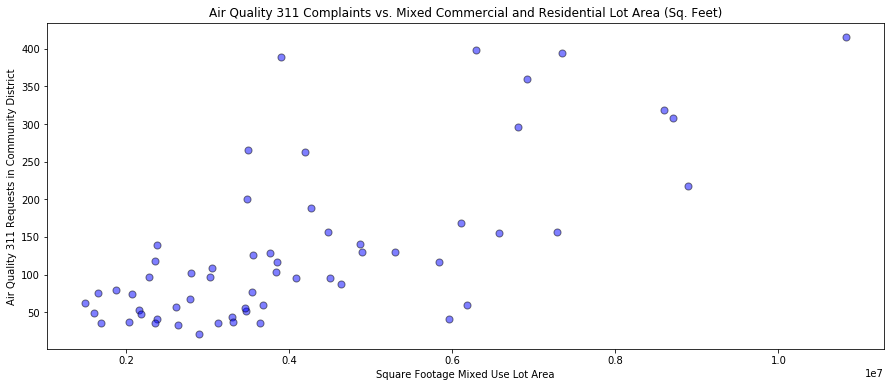

In [22]:
plt.figure(figsize=(15, 6))

plt.scatter(
    np.array(merged.lot_area_mixed_use), 
    np.array(merged.count_complaints), 
    s=50, 
    c='blue', 
    edgecolors='black', 
    alpha=0.5) 

plt.title('Air Quality 311 Complaints vs. Mixed Commercial and Residential Lot Area (Sq. Feet)')
plt.xlabel('Square Footage Mixed Use Lot Area')
plt.ylabel('Air Quality 311 Requests in Community District')

plt.show()

**Step 7. Conduct an OLS linear regression using the indicator values vs. 311 complaint counts and interpret the results.**

In [23]:
x = np.array(merged.lot_area_mixed_use)
y = np.array(merged.count_complaints)

np.corrcoef(x, y)

array([[1.        , 0.70329001],
       [0.70329001, 1.        ]])

In [24]:
y = np.array(merged.count_complaints)

x = np.array(merged.lot_area_mixed_use)
x = sm.add_constant(x)

print(x)

model = sm.OLS(y, x).fit()

print(model.summary())

[[1.0000000e+00 4.2710430e+06]
 [1.0000000e+00 6.2889620e+06]
 [1.0000000e+00 8.7068200e+06]
 [1.0000000e+00 6.8057400e+06]
 [1.0000000e+00 3.9064430e+06]
 [1.0000000e+00 8.8964340e+06]
 [1.0000000e+00 7.3432730e+06]
 [1.0000000e+00 8.5980790e+06]
 [1.0000000e+00 2.3760270e+06]
 [1.0000000e+00 5.8316440e+06]
 [1.0000000e+00 3.8528000e+06]
 [1.0000000e+00 6.1028690e+06]
 [1.0000000e+00 3.2969720e+06]
 [1.0000000e+00 1.6928750e+06]
 [1.0000000e+00 2.9006930e+06]
 [1.0000000e+00 3.6796660e+06]
 [1.0000000e+00 3.6403390e+06]
 [1.0000000e+00 2.6322750e+06]
 [1.0000000e+00 3.1301400e+06]
 [1.0000000e+00 1.6544090e+06]
 [1.0000000e+00 5.9561600e+06]
 [1.0000000e+00 2.3850090e+06]
 [1.0000000e+00 2.7847700e+06]
 [1.0000000e+00 2.1613160e+06]
 [1.0000000e+00 1.0829992e+07]
 [1.0000000e+00 6.9147270e+06]
 [1.0000000e+00 4.8743650e+06]
 [1.0000000e+00 3.4709030e+06]
 [1.0000000e+00 6.1761470e+06]
 [1.0000000e+00 4.1960010e+06]
 [1.0000000e+00 3.7713430e+06]
 [1.0000000e+00 2.7970010e+06]
 [1.0000

In [25]:
p = model.params
print('parameters:', p)

r2 = model.rsquared
print('R2:', r2)

parameters: [-1.74136653e+01  3.61792847e-05]
R2: 0.4946168333673605


**Step 8. Use the linear regression results to add a line of best fit to your scatterplot**

y = 0.0x + -17.41; R2 = 0.495


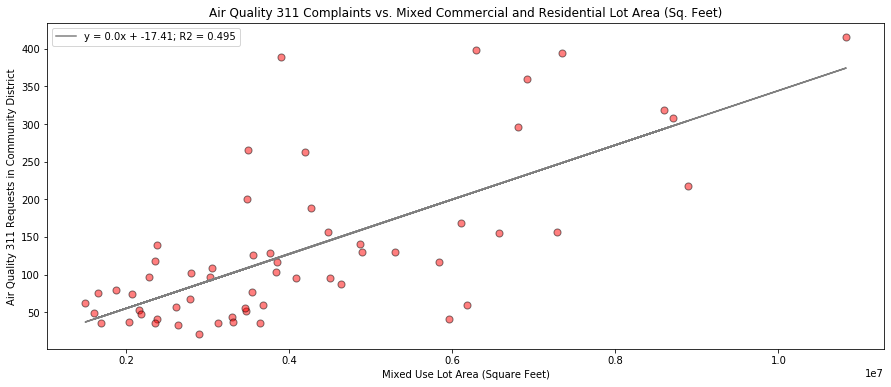

In [26]:
label = 'y = ' + str(round(p[1],2)) + 'x + ' + str(round(p[0],2)) + '; R2 = ' + str(round(r2,3))
print(label)

x_dummy = np.array(merged.lot_area_mixed_use)

plt.figure(figsize=(15, 6))

plt.scatter(
    np.array(merged.lot_area_mixed_use),
    np.array(merged.count_complaints),
    s=50, 
    c='red', 
    edgecolors='black', 
    alpha=0.5) 

plt.plot(
    x_dummy, 
    p[0] + p[1] * x_dummy,
    c='gray',
    label=label)

plt.title('Air Quality 311 Complaints vs. Mixed Commercial and Residential Lot Area (Sq. Feet)')
plt.xlabel('Mixed Use Lot Area (Square Feet)')
plt.ylabel('Air Quality 311 Requests in Community District')
plt.legend()

plt.show()

**Step 9. Write a paragraph explaining the results of your analysis? Have you found a meaningful relationship?**

There does seem to be a moderately strong relationship between the number of air quality complaints and the total square footage of mixed land use. The correlation coefficient is 0.7 and 50% of the variation in air quality complaints is explained by the amount of mixed use land area. The results confirm my hypothesis that community districts with more mixed commercial and residential buildings have a higher number of air quality complaints. This could be because these areas are more highly trafficked so the air quality is worse as a result, or more complaints could surface simply because there are consistently people either using the area for residential, shopping, other commercial purposes.